## prepare dataset


In [1]:
# !pip install tensorflow==2.4.1 tensorflow-gpu==2.4.1 tensorflow-io matplotlib
import os
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.python.ops import gen_audio_ops as audio_ops
from tensorflow.lite.experimental.microfrontend.python.ops import audio_microfrontend_op as frontend_op
import wave as wv
import numpy as np
from IPython.display import Audio
import wave as wv
import random
import soundfile as sf
from sklearn.metrics import confusion_matrix , roc_curve
import seaborn as sns
import IPython.display as ipd
import tensorflow_io as tfio
from config import Config

2025-04-20 15:38:14.369981: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-04-20 15:38:15.792320: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
cof = Config()

In [3]:
def load_wav(filename):

    # Load encoded wav file
    file_contents = tf.io.read_file(filename)  # The contains of the file

    # Decode wav (tensors by channels)
    wav, sample_rate = tf.audio.decode_wav(file_contents, desired_channels=1 )

    # Removes dimensions of size 1 from the shape of a tensor at any index.
    wav = tf.squeeze(wav, axis=-1)

    # Make casting
    sample_rate = tf.cast(sample_rate, dtype=tf.int64)

    # Goes from 44100Hz to 16000hz - amplitude of the audio signal
    # wav = tfio.audio.resample(wav, rate_in=sample_rate, rate_out=16000)
    wav = wav - np.mean(wav)
    wav = wav / np.max(np.abs(wav))
    
    return wav

def get_voice_position(a_file_path_or_wave):
    
    if type(a_file_path_or_wave) == str:  # This argument is a path
        l_audio = load_wav(a_file_path_or_wave)
    else:                                 # This argument is a wave
        l_audio = a_file_path_or_wave
        
    l_audio = l_audio - np.mean(l_audio)
    l_audio = l_audio / np.max(np.abs(l_audio))
    return tfio.audio.trim(l_audio, axis=0, epsilon=cof.NOISE_FLOOR)



def Display_audio( a_file_path_or_wave ):
    if type(a_file_path_or_wave) == str:  # This argument is a path
        display( Audio(a_file_path_or_wave) )
    else:
        l_audio = ipd.Audio(a_file_path_or_wave, rate=cof.SAMPLE_RATE )  # It's a wave
        display(l_audio)

# Get background noise

In [4]:
# Get the background noise files
l_background_noise_files = os.listdir( cof.NOISE_FOLDER_PATH )  # Get all noise files in the directory (White noice, pink noice, ... )

g_all_background_noise_waves = []
for i in l_background_noise_files:
    temp_background_noise = load_wav( os.path.join(cof.NOISE_FOLDER_PATH,i) )
    g_all_background_noise_waves.append( temp_background_noise )
        
# used to get the noise audio        
def Get_background_noise( a_background_noise_file ):

    for l_backgound_index , l_background_file in enumerate( l_background_noise_files ):
        if( l_background_file == a_background_noise_file ):
            return g_all_background_noise_waves[l_backgound_index]
        
Display_audio( Get_background_noise('background.wav') )


2025-04-20 15:38:23.264530: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-04-20 15:38:23.528377: W tensorflow/core/common_runtime/gpu/gpu_device.cc:1960] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...
2025-04-20 15:38:26.689544: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 460878932 exceeds 10% of free system memory.
2025-04-20 15:38:27.165408: W tensorflow/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 460878932 exceeds 10% of free s

## This function adds a noise an audio

In [5]:
def add_noise( a_file_path_or_wave , a_audio_volume=1 , a_noise_volume=0.1 ):
    
    # load the audio file
    if( type(a_file_path_or_wave) == str ):
        l_audio = load_wav( a_file_path_or_wave )
    else:
        l_audio = a_file_path_or_wave
    
    # If the voice is bigger than LENGHT_OF_VOICE, cut it
    l_audio = l_audio[ 0 : cof.LENGHT_OF_VOICE-1 ]

    # Add zero padding, if the voice is small
    l_zero_padding = tf.zeros( [cof.LENGHT_OF_VOICE] - tf.shape(l_audio) ,  dtype=tf.float32 ) # If the wave is smaller than the lenght of voice, add zero padding
    l_audio = tf.concat( [l_zero_padding , l_audio ] , 0 )
    
    # shift the voice to right with random number
    l_voice_start,l_voice_end = get_voice_position( l_audio )
    l_end_gap = len(l_audio) - l_voice_end  # The lenght of voice from the end of voice to the end of audio
    l_random_offset = int(np.random.uniform(0,l_voice_start+l_end_gap))

    l_audio = np.roll( l_audio , l_end_gap-l_random_offset )
    
    # add some random background noise
    l_background_volume = np.random.uniform(0, a_noise_volume ) 
                                                     # Choose the noice strength using random method
                                                     # When SNR increses, the accurecy decresses, so best SNR is 24dB to 42dB 
                                                     # 0 to 0.1 is a good range, as used in 3-5-18-TrainingKeywordSpotting.ipynb
    
    # Choose a random noice to add it to the voice
    l_background_file = np.random.choice( l_background_noise_files ) 
    
    # README.md is not an audio file
    if( l_background_file == 'README.md' ):
        l_background_file = 'pink_noise.wav'
        
    # white_noise and pink_noise are very load, so we want their volume to be small
#     if( l_background_file == 'white_noise.wav' or l_background_file == 'pink_noise.wav' ):
#         if( l_background_volume > 0.5 ):
#             l_background_volume = 0.3

    l_background = Get_background_noise(l_background_file)

    l_background_start = np.random.randint( 0 , len(l_background ) - cof.LENGHT_OF_VOICE ) # The noise file is 10min, so i want to take only a 1sec of it, so I choose a random start
    l_background = tf.cast( l_background[l_background_start:l_background_start+cof.LENGHT_OF_VOICE ], tf.float32)
     
    # mix the audio with the scaled background
    l_audio = l_audio*a_audio_volume + l_background_volume*l_background

    return l_audio

Display_audio( 'test.wav' ) 
Display_audio( add_noise( 'test.wav' ) )

# Preprocessing : Changing audio to spectogram

### MicroPreprocessing

(49, 40, 1)


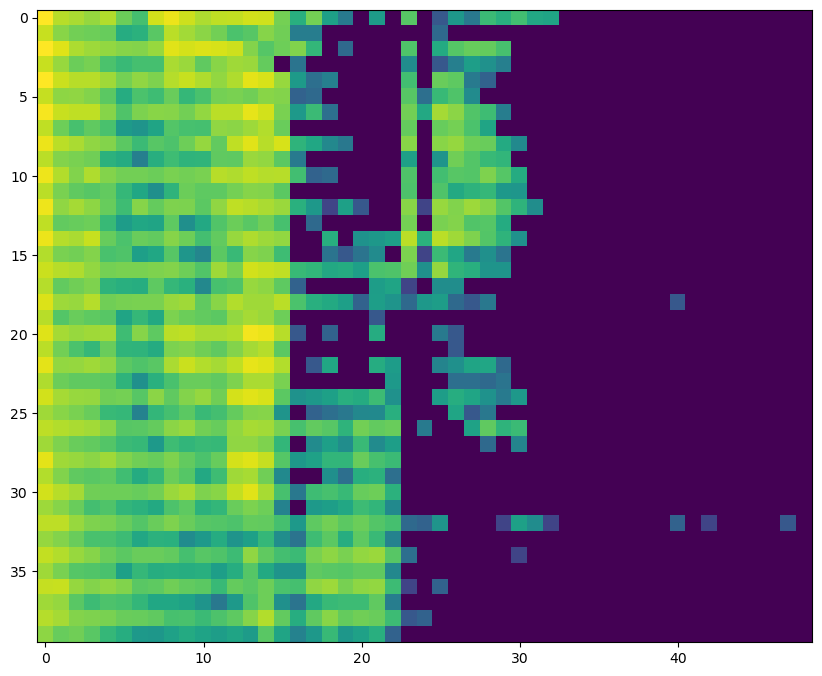

In [6]:
def preprocess_micro( a_file_path_or_wave , a_lable ):

    if( type(a_file_path_or_wave) == str ):
        # Load the wave
        l_wave = load_wav( a_file_path_or_wave )
    else:
        l_wave = a_file_path_or_wave

    # If the wave is bigger than the LENGHT_OF_VOICE, cut it
    # l_wave = l_wave[:LENGHT_OF_VOICE ]

    # Make padding if the signal is smaller than LENGHT_OF_VOICE
    # l_zero_padding = tf.zeros( [LENGHT_OF_VOICE] - tf.shape(l_wave) ,  dtype=tf.float32 ) # If the wave is smaller than the lenght of voice, add zero padding
    # l_wave = tf.concat( [l_zero_padding,l_wave] , 0 )

    # Get spectrogram by using frontend_op.audio_microfrontend method
    l_spectrogram = tf.cast(tf.multiply(l_wave, 32768), tf.int16)
    l_spectrogram = frontend_op.audio_microfrontend(
            l_spectrogram,
            sample_rate=cof.SAMPLE_RATE,
            window_size=cof.WINDOW_SIZE_MS,
            window_step=cof.STRIDE_SIZE_MS,
            num_channels=40  ,
            out_scale=1,
            out_type=tf.float32)

    l_spectrogram = tf.multiply(l_spectrogram, (10.0 / 256.0))

    l_spectrogram = tf.expand_dims( l_spectrogram , axis=2 ) # Add another dimension at index 0 to make pooling


    return l_spectrogram , a_lable

micro,_ = preprocess_micro( "test.wav" , 1 )
print( micro.shape )     

plt.figure(figsize=(10 , 10))
plt.imshow( tf.transpose(micro)[0] )
plt.show()

### MFCC

(49, 40, 1)


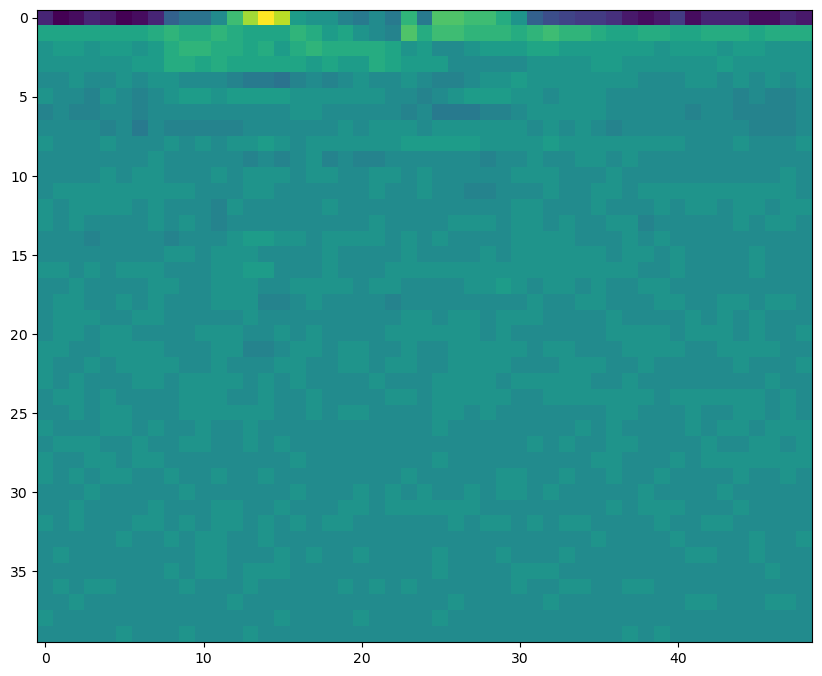

In [7]:
MFCC_FEATURE_MIN = -247.0
MFCC_FEATURE_MAX = 30.0

def preprocess_mfcc( a_file_path_or_wave , a_lable ):

    if( type(a_file_path_or_wave) == str ):
        # Load the wave
        l_wave = load_wav( a_file_path_or_wave )
    else:
        l_wave = a_file_path_or_wave

    # If the wave is bigger than the LENGHT_OF_VOICE, cut it
    l_wave = l_wave[:cof.LENGHT_OF_VOICE ]

    # Make padding if the signal is smaller than LENGHT_OF_VOICE
    l_zero_padding = tf.zeros( [cof.LENGHT_OF_VOICE] - tf.shape(l_wave) ,  dtype=tf.float32 ) # If the wave is smaller than the lenght of voice, add zero padding
    l_wave = tf.concat( [l_zero_padding,l_wave] , 0 )

    # Get spectrogram by using frontend_op.audio_microfrontend method
    l_wave = tf.expand_dims( l_wave , axis=-1 )
    spectrogram = audio_ops.audio_spectrogram(
    l_wave,
    window_size= int(cof.WINDOW_SIZE_MS*cof.SAMPLE_RATE/1000),
    stride=int(cof.STRIDE_SIZE_MS*cof.SAMPLE_RATE/1000),
    magnitude_squared=True)
    
    mfcc  = audio_ops.mfcc(
            spectrogram,
            cof.SAMPLE_RATE,
            upper_frequency_limit=3500,
            lower_frequency_limit=125,
            filterbank_channel_count=40,   
            dct_coefficient_count=40 )
    
    mfcc = tf.expand_dims( mfcc , -1)
    mfcc = tf.squeeze(mfcc, axis=0)

    # Flatten the tensor for processing
    mfcc_array = mfcc
    mfcc = mfcc.numpy()
    flattened_output = mfcc.flatten()
    
    # Apply quantization
    quantized_output = []
    for i in range(len(flattened_output)):
        quantized_value = round((255.0 * (flattened_output[i] - MFCC_FEATURE_MIN)) / (MFCC_FEATURE_MAX - MFCC_FEATURE_MIN))
        quantized_value = max(0, min(255, quantized_value))  # Clamp values between 0 and 255
        quantized_value -= 128  # Adjust by -128
        quantized_output.append(quantized_value)
    
    # Reshape the quantized output back to the original shape
    quantized_output = np.array(quantized_output, dtype=np.int16).reshape(mfcc_array.shape)
    quantized_tensor = tf.convert_to_tensor(quantized_output, dtype=tf.int8)
    
    return quantized_tensor , a_lable

mfcc,_ = preprocess_mfcc( "test.wav" , 1 )
print( mfcc.shape )     

plt.figure(figsize=(10 , 10))
plt.imshow( tf.transpose(mfcc)[0] )
plt.show()

### RFFT (best)

2025-04-20 15:38:36.453144: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1745156316.473809   38618 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1745156316.481020   38618 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-20 15:38:36.501506: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
W0000 00:00:1745156325.742008   38618 gpu_device.cc:2344] Cannot dlopen some GPU libraries. Please make sure the missing libr

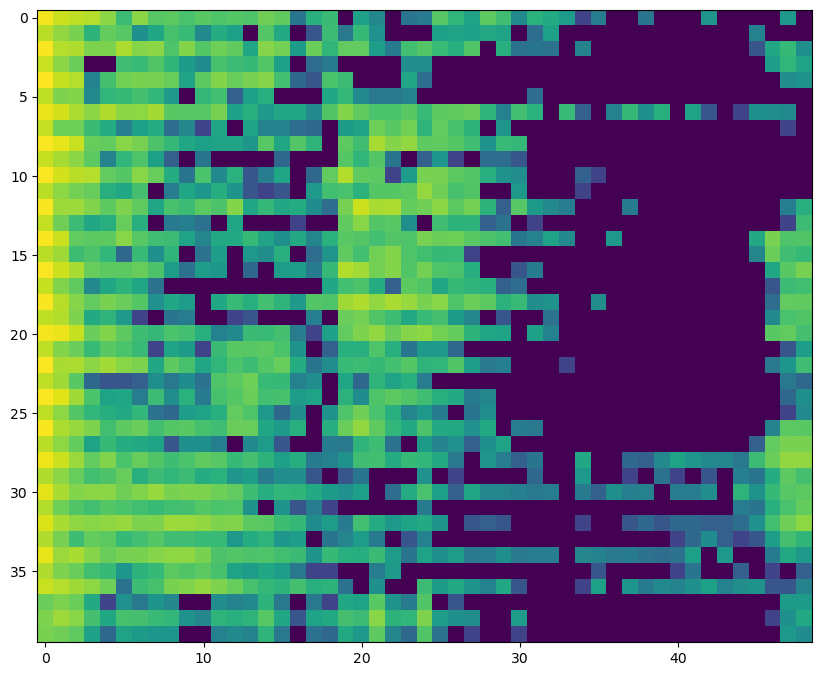

TensorShape([49, 40, 1])

In [8]:
def preprocess_rfft( a_file_path_or_wave , a_lable ):

    if( type(a_file_path_or_wave) == str ):
        # Load the wave
        l_wave = load_wav( a_file_path_or_wave )
    else:
        l_wave = a_file_path_or_wave

    # If the wave is bigger than the LENGHT_OF_VOICE, cut it
    l_wave = l_wave[:cof.LENGHT_OF_VOICE ]

    # Make padding if the signal is smaller than LENGHT_OF_VOICE
    l_zero_padding = tf.zeros( [cof.LENGHT_OF_VOICE] - tf.shape(l_wave) ,  dtype=tf.float32 ) # If the wave is smaller than the lenght of voice, add zero padding
    l_wave = tf.concat( [l_zero_padding,l_wave] , 0 )

    l_array_wave = []
    #change tensor to an array
    for i in l_wave:
        l_array_wave.append( i )

    # save the audio in the imput file
    with open( "shared_data/input_data.txt" , "w" ) as file:
        for item in l_array_wave:
           file.write(f"{item}\n") 

    # Run the script
    !tflite-micro/bazel-bin/tensorflow/lite/micro/examples/micro_speech/audio_preprocessor_1 --output_type=int8 --debug_mode=on --file_to_test='/home/mohammedhamdy32/Desktop/TinyML/notebook/tflite-micro/tensorflow/lite/micro/examples/micro_speech/testdata/no_1000ms.wav'       

    # Get spectrogram by using frontend_op.audio_microfrontend method
    with open("shared_data/output_data.txt", "r") as file:
        content = [float(line.strip()) for line in file] 

    content = tf.convert_to_tensor(content)
    content = tf.reshape(content, (49, 40, 1))


    return content , a_lable

rftt,_ = preprocess_rfft( "test.wav" , 1 )
print( rftt.shape )     

plt.figure(figsize=(10 , 10))
plt.imshow( tf.transpose(rftt)[0] )
plt.show()
rftt.shape

In [9]:
preprocess_fun = preprocess_micro

# prepare dataset and add noise to audio

In [10]:
train_preprocessed_dataset = [] # List contains my train preprocessed dataset
test_preprocessed_dataset  = []

### go

In [11]:
WORD = "on"
WORD_LABLE = 0

LABLE = np.array( tf.one_hot( [WORD_LABLE], depth=cof.NUMBER_OF_CLASSES)[0] , dtype=np.float32)
PATH = os.path.join( cof.DATASET_FOLDER_PATH , WORD )

orignal_files_1 = os.listdir( PATH ) 
orignal_files = orignal_files_1 

SAMPLES = len(orignal_files)

random.seed(42)
random.shuffle(orignal_files)


train_size = int(cof.TRAIN_RATIO*len(orignal_files))
test_size  = int(cof.TEST_RATIO*len(orignal_files))
train_file = orignal_files[:train_size]
test_file  = orignal_files[train_size:]

print( f"Number of voices  = {len(orignal_files)}" )
samples_files = random.sample(orignal_files, SAMPLES)
print( f"Number of samples = {len(samples_files)}" )
x = ''
for i in range(1):
    
    print(f'step : {i}')
    # Loop on all files and pass them to add_noice, then save the new voices
    for i , file_name in enumerate(samples_files) :
        # Add noise to the orignal signal twise
        if( file_name in orignal_files_1 ):
            new_voice = add_noise( PATH + f'/' + file_name )  
        else:
            print('ERROR')
            break
        
        # Put voice in train ot test    
        if( file_name in train_file ):    
            train_preprocessed_dataset.append( preprocess_fun( new_voice , LABLE ) )
        elif( file_name in test_file ):
            test_preprocessed_dataset.append(  preprocess_fun( new_voice , LABLE ) )


# To know that I have finshed
print(LABLE)
print( "************************** DONE *****************************" )
Display_audio( new_voice )

Number of voices  = 3845
Number of samples = 3845
step : 0
[1. 0. 0. 0.]
************************** DONE *****************************


#### stop

In [12]:
WORD = "off"
WORD_LABLE = 1

LABLE = np.array( tf.one_hot( [WORD_LABLE], depth=cof.NUMBER_OF_CLASSES)[0] , dtype=np.float32)
PATH = os.path.join( cof.DATASET_FOLDER_PATH , WORD )

orignal_files_1 = os.listdir( PATH ) 
orignal_files = orignal_files_1 

SAMPLES = len(orignal_files)

random.seed(42)
random.shuffle(orignal_files)


train_size = int(cof.TRAIN_RATIO*len(orignal_files))
test_size  = int(cof.TEST_RATIO*len(orignal_files))
train_file = orignal_files[:train_size]
test_file  = orignal_files[train_size:]

print( f"Number of voices  = {len(orignal_files)}" )
samples_files = random.sample(orignal_files, SAMPLES)
print( f"Number of samples = {len(samples_files)}" )
    
for i in range(1):
    
    print(f'step : {i}')
    # Loop on all files and pass them to add_noice, then save the new voices
    for i , file_name in enumerate(samples_files) :
        # Add noise to the orignal signal twise
        if( file_name in orignal_files_1 ):
            new_voice = add_noise( PATH + f'/' + file_name )  
        else:
            print('ERROR')
            break
        
        # Put voice in train ot test    
        if( file_name in train_file ):    
            train_preprocessed_dataset.append( preprocess_fun( new_voice , LABLE ) )
        elif( file_name in test_file ):
            test_preprocessed_dataset.append(  preprocess_fun( new_voice , LABLE ) )


# To know that I have finshed
print(LABLE)
print( "************************** DONE *****************************" )
Display_audio( new_voice )

Number of voices  = 3745
Number of samples = 3745
step : 0
[0. 1. 0. 0.]
************************** DONE *****************************


### silence

In [13]:
SAMPLES = len(orignal_files)

LABLE = np.array( tf.one_hot( [cof.NUMBER_OF_CLASSES-2], depth=cof.NUMBER_OF_CLASSES)[0] , dtype=np.float32)

print( f"Number of samples = {SAMPLES}" )

for i in range(1):
    
    print(f'step : {i}')
    # Loop on all files and pass them to add_noice, then save the new voices
    for i in range(SAMPLES) :
        # Add noise only, not voice
        new_voice = add_noise( 'test.wav', a_noise_volume=0.1 , a_audio_volume=0 )   

        # Put voice in train ot test    
        if random.random() < cof.TRAIN_RATIO :  
            train_preprocessed_dataset.append( preprocess_fun( new_voice , LABLE ) )
        else:
            test_preprocessed_dataset.append(  preprocess_fun( new_voice , LABLE ) )



# To know that I have finshed
print( "************************** DONE *****************************" )
print(LABLE)
Display_audio( new_voice )

Number of samples = 3745
step : 0
************************** DONE *****************************
[0. 0. 1. 0.]


### Last class  (unknown)
#### Add any other datasets you want

In [14]:
remove_words = ["on",'off']
SAMPLES = len(orignal_files)
LABLE = np.array( tf.one_hot( [cof.NUMBER_OF_CLASSES-1], depth=cof.NUMBER_OF_CLASSES)[0] , dtype=np.float32)

# Get words that you want to use
words_1 = os.listdir( cof.PETER_WARDEN_PATH ) # Peter warden dataset
words_2 = os.listdir( cof.MY_VOICE_WORDS_PATH ) # My dataset
words_3 = os.listdir( cof.ARABIC_WORDS_PATH ) # Arabic words dataset from kaggle

words = words_1 + words_2 + words_3 
random.seed(42)
random.shuffle(words)

# Remove folders starts with _
words = [file for file in words if not file.startswith("_")]

# Remove words that is used in classes
words = [file for file in words if file not in remove_words]

train_size = int(cof.TRAIN_RATIO*len(words))

train_file = words[:train_size]
test_file  = words[train_size:]
    
for i in range(SAMPLES):
    
    # Choose a random word
    WORD = np.random.choice( words )

    if WORD in words_1:
        orignal_files = os.listdir( cof.PETER_WARDEN_PATH + f'/{WORD}' ) # Peter warden dataset
    elif WORD in words_2:    
        orignal_files = os.listdir( cof.MY_VOICE_WORDS_PATH + f'/{WORD}' ) # My dataset
    elif WORD in words_3: 
        orignal_files = os.listdir( cof.ARABIC_WORDS_PATH + f'/{WORD}' ) # My dataset
    else:
        print('ERROR')
        break

    # Choose a randome voice
    voice_file_name = np.random.choice( orignal_files )

    # Get this voice and add noice to it
    if WORD in words_1:
        voice = add_noise( cof.PETER_WARDEN_PATH + f'/{WORD}/' + voice_file_name )   

    elif WORD in words_2:    
        voice = add_noise( cof.MY_VOICE_WORDS_PATH + f'/{WORD}/' + voice_file_name )   

    elif WORD in words_3: 
        voice = add_noise( cof.ARABIC_WORDS_PATH + f'/{WORD}/' + voice_file_name )   

    else:
        print('ERROR')
        break

    # Append this voice in our list after making preprocessing
    # Put voice in train ot test    
    if( WORD in train_file ):    
        train_preprocessed_dataset.append( preprocess_fun( new_voice , LABLE ) )
    elif( WORD in test_file ):
        test_preprocessed_dataset.append(  preprocess_fun( new_voice , LABLE ) )
        
            
# To know that I have finshed
print(LABLE)
print( "************************** DONE *****************************" )
Display_audio( voice )

[0. 0. 0. 1.]
************************** DONE *****************************


# Visualizing the distribution of classes dataset

In [15]:
class_1_counter = 0
class_2_counter = 0
class_3_counter = 0
class_4_counter = 0
class_5_counter = 0
class_6_counter = 0
class_7_counter = 0

for i in train_preprocessed_dataset:
        
    if  ( np.array_equal( i[1] , tf.one_hot([0] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
        class_1_counter = class_1_counter + 1
    elif( np.array_equal( i[1] , tf.one_hot([1] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_2_counter = class_2_counter + 1
    elif( np.array_equal( i[1] , tf.one_hot([2] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_3_counter = class_3_counter + 1
    elif( np.array_equal( i[1] , tf.one_hot([3] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_4_counter = class_4_counter + 1            
    elif( np.array_equal( i[1] , tf.one_hot([4] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_5_counter = class_5_counter + 1
    elif( np.array_equal( i[1] , tf.one_hot([5] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_6_counter = class_6_counter + 1            
    elif( np.array_equal( i[1] , tf.one_hot([6] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_7_counter = class_7_counter + 1
    else:
        print( 'EROOR' )
        break


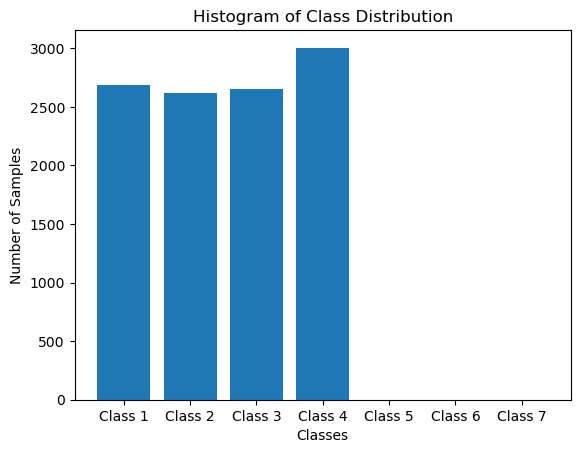

In [16]:
# List of class counters and class labels
counters = [class_1_counter, class_2_counter, class_3_counter, class_4_counter, class_5_counter, class_6_counter, class_7_counter]
class_labels = ['Class 1', 'Class 2', 'Class 3', 'Class 4', 'Class 5', 'Class 6', 'Class 7']

# Plotting the histogram
plt.bar(class_labels, counters)

# Adding titles and labels
plt.xlabel('Classes')
plt.ylabel('Number of Samples')
plt.title('Histogram of Class Distribution')

# Display the plot
plt.show()

In [17]:
class_1_counter = 0
class_2_counter = 0
class_3_counter = 0
class_4_counter = 0
class_5_counter = 0
class_6_counter = 0
class_7_counter = 0

for i in test_preprocessed_dataset:
        
    if  ( np.array_equal( i[1] , tf.one_hot([0] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
        class_1_counter = class_1_counter + 1
    elif( np.array_equal( i[1] , tf.one_hot([1] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_2_counter = class_2_counter + 1
    elif( np.array_equal( i[1] , tf.one_hot([2] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_3_counter = class_3_counter + 1
    elif( np.array_equal( i[1] , tf.one_hot([3] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_4_counter = class_4_counter + 1            
    elif( np.array_equal( i[1] , tf.one_hot([4] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_5_counter = class_5_counter + 1
    elif( np.array_equal( i[1] , tf.one_hot([5] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_6_counter = class_6_counter + 1            
    elif( np.array_equal( i[1] , tf.one_hot([6] , depth=cof.NUMBER_OF_CLASSES).numpy()[0] ) ):
         class_7_counter = class_7_counter + 1
    else:
        print( 'EROOR' )
        break


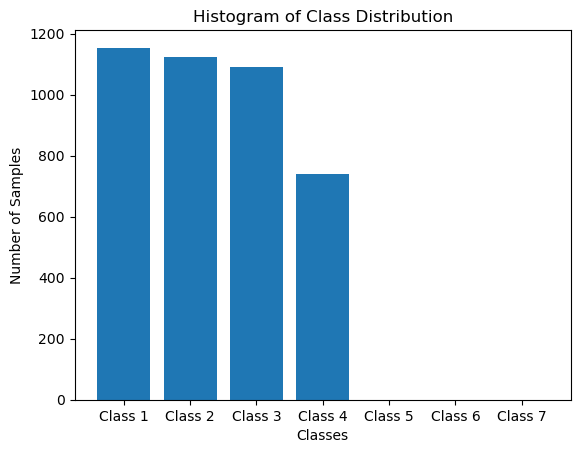

In [18]:
# List of class counters and class labels
counters = [class_1_counter, class_2_counter, class_3_counter, class_4_counter, class_5_counter, class_6_counter, class_7_counter]
class_labels = ['Class 1', 'Class 2', 'Class 3', 'Class 4', 'Class 5', 'Class 6', 'Class 7']

# Plotting the histogram
plt.bar(class_labels, counters)

# Adding titles and labels
plt.xlabel('Classes')
plt.ylabel('Number of Samples')
plt.title('Histogram of Class Distribution')

# Display the plot
plt.show()

In [19]:
# Operation is a way to "unzip" a list of tuples. If My_dataset is a list where each
# element is a tuple (spectrogram, label), then zip(*My_dataset) will unpack these tuples
# into two separate tuples: one for spectrograms and one for labels.
train_spectrograms , train_labels = zip(*train_preprocessed_dataset)
test_spectrograms , test_labels = zip(*test_preprocessed_dataset)
len(train_spectrograms)

10970

# Save spectogram numpy data in a .npz file

In [21]:
# save the computed data
np.savez_compressed(
    "numpy_files/train.npz",
    X=train_spectrograms, Y=train_labels )

# save the computed data
np.savez_compressed(
    "numpy_files/test.npz",
    X=test_spectrograms, Y=test_labels )

print("Saved training data")

Saved training data
